# Ciência de Dados aplicada à otimização do planejamento de manutenção

### Bibliotecas

In [54]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import os
for dirname, _, filenames in os.walk('/kaggle/input/datasetbix'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

from ydata_profiling import ProfileReport
from IPython.display import display, HTML
import matplotlib.pyplot as plt

## modelo
from sklearn import preprocessing
from sklearn.impute import KNNImputer, SimpleImputer
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.model_selection import train_test_split, cross_validate
from sklearn.preprocessing import OneHotEncoder, StandardScaler, OrdinalEncoder
from imblearn.over_sampling import SMOTE
from sklearn.compose import ColumnTransformer
from sklearn.decomposition import PCA, TruncatedSVD
from imblearn.pipeline import Pipeline
from sklearn.metrics import average_precision_score, mean_absolute_error, roc_curve, auc, roc_auc_score
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, precision_recall_curve

## vis
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns
from collections import Counter

# check xgboost version
from xgboost import XGBClassifier

import timeit
import warnings
warnings.filterwarnings("ignore")

/kaggle/input/datasetbix/air_system_previous_years.csv
/kaggle/input/datasetbix/air_system_present_year.csv


### Layout

In [1]:
%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (12, 6)

pd.set_option('display.max_columns', 200)
pd.set_option('display.width', 1000)

rc={'font.size': 16, 'axes.labelsize': 16, 'legend.fontsize': 16,
    'axes.titlesize': 18, 'xtick.labelsize': 16, 'ytick.labelsize': 16}

sns.set(rc=rc)
sns.set_style("darkgrid")
sns.set_palette("pastel")

### Configurações

In [2]:
#pd.set_option('max_columns', 200)
pd.options.display.max_columns = 200 

# Define um valor maior para a largura máxima das colunas
pd.options.display.max_colwidth = 1000

# Definindo o formato para exibição das variáveis numéricas
pd.options.display.float_format = '{:.2f}'.format

seed = 42
np.random.seed(seed)

### Funções

In [3]:
def check_time(start, end):
    seg = end - start
    dias = seg // 86400
    Seg_Restantes_Após_Dias = seg % 86400
    horas = Seg_Restantes_Após_Dias // 3600         # Divisão inteira
    Seg_Restantes_Apos_Hora = seg % 3600            # Resto da divisão por 3600
    minutos = Seg_Restantes_Apos_Hora // 60         # Divisão inteira dos segundos restantes
    Seg_Restantes_Apos_Minutos = seg % 60
    #print(minutos,'minutos','e', '%.2f' % Seg_Restantes_Apos_Minutos,'segundos')
    print(dias,'dias', horas,'horas', minutos,'minutos','e', '%.2f' % Seg_Restantes_Apos_Minutos,'segundos')

start=timeit.default_timer()

In [4]:
def plot_feature_freq(df, feature, top_n=10):
    value_counts = df[feature].value_counts(dropna=True)
    top_values = value_counts.head(top_n)
    other_values_count = value_counts.iloc[top_n:].sum()

    if other_values_count > 0:
        top_values['Outros'] = other_values_count

    total = top_values.sum()

    plt.figure(figsize=(5, 4))
    ax = sns.barplot(x=top_values.index, y=top_values.values, palette='viridis')

    for p in ax.patches:
        ax.annotate('{:.0f}'.format(p.get_height()), (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center', xytext=(0, 10), textcoords='offset points')

        percentage = p.get_height() / total * 100
        ax.annotate('{:.1f}%'.format(percentage), (p.get_x() + p.get_width() / 2., 0),
                    ha='center', va='center', xytext=(0, -40), textcoords='offset points')

    ax.set(xlabel='class', ylabel='Quantidade')
    plt.xticks(rotation=0)
    plt.tight_layout()
    plt.show()

In [5]:
def just_check_nan(df):
    # Check NaN Pandas and Numpy
    missing_val_count_by_column = (df.isna().sum())

    columns_with_nan = missing_val_count_by_column[missing_val_count_by_column > 0]
    print('Dados com NaN:')
    print(columns_with_nan)
    print('')
    print('columns_with_nan.shape', columns_with_nan.shape)
    print('')

In [6]:
def convert_to_int(df):
    # Substituir 'na' por NaN
    df.replace('na', np.nan, inplace=True)

    # Identificar colunas numéricas e converter para inteiro
    for col in df.columns:
        if df[col].dtype == 'object':
            try:
                df[col] = pd.to_numeric(df[col])
            except ValueError:
                pass  # Ignorar colunas que não podem ser convertidas para numérico

    # Converter colunas numéricas para inteiros, ignorando NaNs
    df = df.apply(pd.to_numeric, errors='ignore').convert_dtypes()
    
    # Garantir que todas as colunas numéricas sejam do tipo int64
    for col in df.select_dtypes(include=['Int64', 'float', 'Int32']).columns:
        df[col] = df[col].astype('Int64')
    
    return df

***
# 1) Definição do problema e objetivo do projeto

## 1.1) Contexto

Uma nova empresa de consultoria em ciência de dados foi contratada para solucionar e aprimorar o planejamento de manutenção de uma empresa terceirizada de transporte. A empresa mantém um número médio de caminhões em sua frota para fazer entregas em todo o país, mas nos últimos 3 anos vem percebendo um grande aumento nos gastos relacionados à manutenção do sistema de ar de seus veículos, mesmo tendo sido mantido o tamanho da sua frota relativamente constante. O custo de manutenção deste sistema específico é mostrado abaixo em dólares:

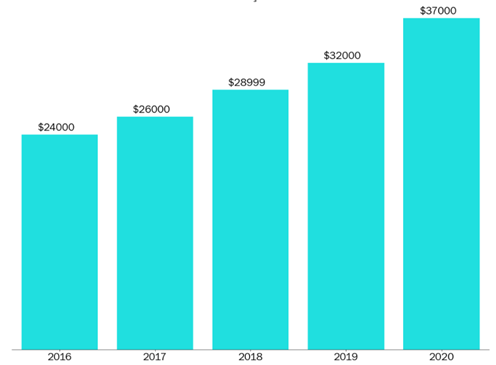
 
Seu objetivo como consultor é diminuir os custos de manutenção deste sistema específico. Os custos de manutenção do sistema de ar podem variar dependendo das condições reais do caminhão.

-	Caso um caminhão seja enviado para manutenção, mas não apresente nenhum defeito nesse sistema, serão cobrados cerca de R$10 pelo tempo gasto na inspeção pela equipe especializada.
-	Caso um caminhão seja enviado para manutenção e apresente defeito neste sistema, serão cobrados R$25 para realizar o serviço de reparo preventivo.
-	Caso um caminhão com defeito no sistema de ar não seja enviado diretamente para manutenção, a empresa paga R$500 para realizar a manutenção corretiva do mesmo, considerando mão de obra, reposição de peças e outros possíveis inconvenientes (caminhão quebrou no meio da pista por exemplo).

Durante a reunião de alinhamento com os responsáveis pelo projeto e a equipe de TI da empresa, algumas informações foram passadas para você:

-	A equipe técnica informou que todas as informações referentes ao sistema aéreo dos caminhos serão disponibilizadas para você, mas por questões burocráticas em relação aos contratos da empresa, todas as colunas tiveram que ser codificadas.
-	A equipa técnica informou ainda que dada a recente digitalização da empresa, poderão faltar algumas informações na base de dados que lhe foi enviada.

Por fim, a equipe técnica informou que a fonte da informação vem do setor de manutenção da empresa, onde criaram uma coluna no banco de dados chamada classe : “pos” seriam aqueles caminhões que apresentavam defeitos no sistema de ar e “neg” seria aqueles caminhões que apresentavam defeito em qualquer sistema que não fosse o de ar.

Os responsáveis pelo projeto estão muito entusiasmados com a iniciativa e, ao solicitarem uma prova técnica de conceito, colocaram como principais requisitos:
-	Podemos reduzir nossos gastos com esse tipo de manutenção utilizando técnicas de IA?
-	Você pode me apresentar os principais fatores que apontam para uma possível falha neste sistema?
Esses pontos, segundo eles, são importantes para convencer a diretoria executiva a abraçar a causa e aplicá-la em outros sistemas de manutenção durante o ano de 2022.


## 1.1) Dicionario de dados

- “pos” seriam aqueles caminhões que apresentavam defeitos no sistema de ar

- “neg” seria aqueles caminhões que apresentavam defeito em qualquer sistema que não fosse o de ar.

***
# 1) Coleta e preparação dos dados

## 1.1) Coleta dos dados

In [7]:
client_chunks = []
previous_years_data_amostra = pd.read_csv('/kaggle/input/datasetbix/air_system_previous_years.csv', 
                                          header = 0, 
                                          index_col = False, 
                                          names = None, 
                                          low_memory = False, 
                                          chunksize = 10**5) 

In [8]:
for chunk in previous_years_data_amostra:

    new_clients = pd.DataFrame(chunk)

    # filter data chunk with frac percentage
    new_clients = new_clients.sample(frac = 0.3)
    new_clients = new_clients.drop_duplicates()

    # saves to list
    client_chunks.append(new_clients)

previous_years_data = pd.concat(client_chunks).reset_index(drop = True)

In [9]:
previous_years_data.shape

(18000, 171)

In [96]:
# # Carregar os dados (para responder as questões do hire)
previous_years_data_teste = pd.read_csv('/kaggle/input/datasetbix/air_system_previous_years.csv')

present_year_data = pd.read_csv('/kaggle/input/datasetbix/air_system_present_year.csv')

## 1.1.1) Converte os valores para INT e substitui NA por NaN (not a number)

In [11]:
previous_years_data = convert_to_int(previous_years_data)

In [12]:
present_year_data = convert_to_int(present_year_data)

## 1.2) Exibir as primeiras linhas para entender os dados

In [13]:
previous_years_data.head()

,class,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,ag_003,ag_004,ag_005,ag_006,ag_007,ag_008,ag_009,ah_000,ai_000,aj_000,ak_000,al_000,am_0,an_000,ao_000,ap_000,aq_000,ar_000,as_000,at_000,au_000,av_000,ax_000,ay_000,ay_001,ay_002,ay_003,ay_004,ay_005,ay_006,ay_007,ay_008,ay_009,az_000,az_001,az_002,az_003,az_004,az_005,az_006,az_007,az_008,az_009,ba_000,ba_001,ba_002,ba_003,ba_004,ba_005,ba_006,ba_007,ba_008,ba_009,bb_000,bc_000,bd_000,be_000,bf_000,bg_000,bh_000,bi_000,bj_000,bk_000,bl_000,bm_000,bn_000,bo_000,bp_000,bq_000,br_000,bs_000,bt_000,bu_000,bv_000,bx_000,by_000,bz_000,ca_000,cb_000,cc_000,cd_000,ce_000,cf_000,cg_000,ch_000,ci_000,cj_000,ck_000,cl_000,cm_000,cn_000,cn_001,cn_002,cn_003,cn_004,cn_005,cn_006,cn_007,cn_008,cn_009,co_000,cp_000,cq_000,cr_000,cs_000,cs_001,cs_002,cs_003,cs_004,cs_005,cs_006,cs_007,cs_008,cs_009,ct_000,cu_000,cv_000,cx_000,cy_000,cz_000,da_000,db_000,dc_000,dd_000,de_000,df_000,dg_000,dh_000,di_000,dj_000,dk_000,dl_000,dm_000,dn_000,do_000,dp_000,dq_000,dr_000,ds_000,dt_000,du_000,dv_000,dx_000,dy_000,dz_000,ea_000,eb_000,ec_00,ed_000,ee_000,ee_001,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,neg,38360,<NA>,0,<NA>,0,0,0,0,0,0,262,406596,2321672,709276,20588,0,1617448,0,0,0,0,0,2721998,2142968,828372,535020,0,0,0,0,0,0,0,0,0,0,0,573258,2883806,0,1330,0,2866,516,712,1804,2159964,1281122,11408,2,0,0,1849278,456940,203452,157682,197556,577010,16476,0,0,0,3550722,0,48,228,0,1617448,73016,353454,473930,278960,275680,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,269400,38360,3550722,3550722,3564370,18827,81872,109986,1127220,3458394,1209600,0,<NA>,<NA>,<NA>,2810733,0,643926,0,0,0,0,0,2074,689854,1816762,899086,41774,7458,1386,<NA>,0,3550722,<NA>,4792,508,47090,662168,135270,1164408,1420268,23666,224,0,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,4236,780,0,0,0,0,0,0,0,0,40138,56730,9116,0,0,177340,26996,5190340,736258,0,0,0,0,299280,1007,1050,680894,1294122,413614,128948,232640,182112,124972,104546,286396,10150,0,0
1,neg,8,<NA>,6,6,0,0,0,0,0,0,160,2866,6150,0,0,0,1924,0,0,0,0,0,24210,22182,7194,112,0,0,0,0,6,14,0,0,0,0,0,0,0,0,9176,0,2952,26,20,42,2100,4036,0,0,0,0,4950,514,70,84,64,178,2058,1258,0,0,31432,0,2,0,0,1924,154,6112,1062,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,7040,8,31432,31432,37258,84,0,3038,31260,9176,1209600,278,2,6,0,1795,0,2369,0,22,0,0,18,2690,2172,3472,824,0,0,0,0,4,31432,<NA>,5046,26,16,18,10,868,2840,348,4,0,2,12,1870,34,0,0,0,0,2002,46,60,0,0,0,0,0,0,0,0,156,0,0,0,0,10,2,5040,510,0,0,0,0,0,93,56,4682,1436,26,8,2892,18,94,20,0,0,0,0
2,neg,43980,<NA>,212,176,0,0,0,0,0,0,502,11228,1779768,1398660,63606,1800,1562598,0,538,0,0,0,2815070,2435856,576446,302232,0,0,0,0,560,188,0,0,0,0,0,0,86800,912844,2255920,0,4584,3022,2794,289770,2488176,467196,22,0,0,0,1412050,581336,287832,242858,244032,480572,6884,0,0,0,3392380,0,26,78,24,1562598,48050,225064,347818,220160,194520,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,153860,43979,3392380,3392380,3388002,19178,924,91230,964780,3255564,1209600,112410,0,216,0,2597114,0,654748,0,0,0,0,0,440,195016,1606770,1341874,99748,10440,1276,52,72,3392380,<NA>,6908,778,115254,451994,188562,1639048,839076,13840,104,0,342,374,2592342,2854,0,786,0,0,2671284,3126,1208,0,0,0,0,0,0,0,0,25546,53270,8632,0,0,111912,20578,139240,16534,0,0,0,0,3979280,1639,1662,684446,647080,409274,193536,374626,270080,234822,163272,249406,29022,0,0
3,neg,47196,<NA>,344,310,0,0,0,0,0,0,2166,115448,2222024,822046,22630,402,1240042,0,0,0,0,0,2820556,2360462,693424,366404,0,0,0,0,914,490,0,0,0,0,0,59322,1481660,1421142,222592,0,4304,2768,3420,17876,2130582,1025730,36,0,0,0,1257132,748210,296994,197982,142730,111232,162078,268198,160,0,3514778,196,100,244,10,1240042,33214,364946,324754,233620,232620,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,218240,47196,3514778,3514778,3493844,18980,3588,102598,1086140,3184716,1209600,91052,2,62,0,2781545,36,400001,0,0,0,0,0,5604,792166,1861046,480704,36718,7884,594,0,6,3514778,<NA>,6816,906,109872,196804,187622,2335434,338336,8824,102,0,498,

In [14]:
previous_years_data.dtypes.value_counts()

Int64             170
string[python]      1
Name: count, dtype: int64

In [15]:
present_year_data.head()

,class,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,ag_003,ag_004,ag_005,ag_006,ag_007,ag_008,ag_009,ah_000,ai_000,aj_000,ak_000,al_000,am_0,an_000,ao_000,ap_000,aq_000,ar_000,as_000,at_000,au_000,av_000,ax_000,ay_000,ay_001,ay_002,ay_003,ay_004,ay_005,ay_006,ay_007,ay_008,ay_009,az_000,az_001,az_002,az_003,az_004,az_005,az_006,az_007,az_008,az_009,ba_000,ba_001,ba_002,ba_003,ba_004,ba_005,ba_006,ba_007,ba_008,ba_009,bb_000,bc_000,bd_000,be_000,bf_000,bg_000,bh_000,bi_000,bj_000,bk_000,bl_000,bm_000,bn_000,bo_000,bp_000,bq_000,br_000,bs_000,bt_000,bu_000,bv_000,bx_000,by_000,bz_000,ca_000,cb_000,cc_000,cd_000,ce_000,cf_000,cg_000,ch_000,ci_000,cj_000,ck_000,cl_000,cm_000,cn_000,cn_001,cn_002,cn_003,cn_004,cn_005,cn_006,cn_007,cn_008,cn_009,co_000,cp_000,cq_000,cr_000,cs_000,cs_001,cs_002,cs_003,cs_004,cs_005,cs_006,cs_007,cs_008,cs_009,ct_000,cu_000,cv_000,cx_000,cy_000,cz_000,da_000,db_000,dc_000,dd_000,de_000,df_000,dg_000,dh_000,di_000,dj_000,dk_000,dl_000,dm_000,dn_000,do_000,dp_000,dq_000,dr_000,ds_000,dt_000,du_000,dv_000,dx_000,dy_000,dz_000,ea_000,eb_000,ec_00,ed_000,ee_000,ee_001,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,neg,60,0,20,12,0,0,0,0,0,2682,4736,3862,1846,0,0,0,3976,0,0,0,1520,2374,11516,9480,111258,470,0,0,0,0,58,26,0,0,0,0,0,0,0,0,13124,2,1956,434,76,174,190,6198,1148,2948,2,0,8762,2566,480,380,196,516,86,66,74,0,124340,4,6,4,0,3976,318,107662,3458,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,110980,59,124340,124340,184970,54,686,12246,123880,13196,1209600,598,0,6,0,5913,0,5851,6,30,0,2,5512,4674,1388,1508,38,4,0,0,8,12,124340,0,1550,14,36,26,920,430,7650,2294,206,0,22,42,5336,1276,0,0,0,0,6598,70,112,0,0,0,0,0,0,0,0,340,0,0,1100,574,232,66,780,882,0,4,0,0,0,465,90,7502,3156,1098,138,412,654,78,88,0,0,0,0
1,neg,82,0,68,40,0,0,0,0,0,0,748,12594,3636,0,0,0,5244,0,60,0,0,0,23174,18166,23686,1270,0,0,0,0,12,82,0,0,0,0,0,0,0,692,16286,0,280,44,50,1274,866,3362,11102,0,0,0,12564,1756,638,276,172,132,812,308,192,128,46894,4,2,38,0,5244,360,20520,3134,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,23320,81,46894,46894,48324,68,0,4486,46480,17050,1209600,726,2,4,0,7224,0,7768,0,42,0,0,4,7064,6200,2452,1246,12,0,0,14,54,46894,0,2202,28,114,350,700,1708,9622,2174,80,0,80,206,7802,1466,0,0,0,0,7918,78,40,0,0,0,0,0,0,0,0,352,0,0,3996,584,200,62,37580,3756,6368,36,0,0,0,2,102,10040,3310,1068,276,1620,116,86,462,0,0,0,0
2,neg,66002,2,212,112,0,0,0,0,0,199486,1358536,1952422,452706,25130,520,0,1891670,0,0,0,77898,110548,3605894,3291610,959756,286536,0,0,0,0,106,340,0,0,0,0,0,24286,681260,2808472,474782,0,22984,894,1162,1304,1856,388700,3424812,123828,23260,0,1662580,667960,387998,226078,161558,148288,154908,220820,147744,210866,4644422,958,7848,3624,0,1891670,47066,692800,265492,336240,194360,245240,<NA>,<NA>,<NA>,<NA>,<NA>,175480,66002,4644422,4644422,4608738,22706,2272,95510,1006260,3991552,1209600,126310,0,104,0,3594885,0,374649,148,720,0,5154,174956,622312,1002504,793938,541734,345896,300806,201500,52,92,4644422,0,24818,964,162660,215004,217930,3038612,322718,6080,14,0,226,572,3593728,1911060,0,284,0,0,3613906,4218,692,0,0,0,0,0,0,0,0,25278,9438,2504,10262714,1278664,109700,19072,9520,4902,4434614,70900,0,0,26002880,2057,2158,396312,538136,495076,380368,440134,269556,1315022,153680,516,0,0,0
3,neg,59816,<NA>,1010,936,0,0,0,0,0,0,123922,984314,1680050,1135268,92606,14038,1772828,0,0,0,1116,2372,3546760,3053176,652616,423374,0,0,7274,0,1622,432,0,0,0,0,0,6388,1091104,2930694,2012,0,3526,904,1426,223226,2663348,1137664,104,0,0,0,1283806,928212,345132,265930,194770,158262,219942,620264,13880,0,4201350,98,238,880,16,1772828,51468,331744,316130,176000,208420,159380,<NA>,<NA>,<NA>,<NA>,<NA>,100120,59816,4201350,4201350,4203050,29967,26214,51894,562680,4030198,1209600,114684,0,144,0,3387773,38633,599624,0,0,0,0,14308,475410,1109740,1528024,837114,58942,6220,440,1278,1292,4201350,<NA>,6846,810,70090,345884,191284,2454600,926846,33558,280,0,1516,1398,2050280,64066,0,674,0,46,3413978,2924,414,

In [16]:
present_year_data.dtypes.value_counts()

Int64             170
string[python]      1
Name: count, dtype: int64

## 1.3) Verificar valores ausentes

In [17]:
just_check_nan(previous_years_data)

Dados com NaN:
ab_000    13905
ac_000     1023
ad_000     4461
ae_000      780
af_000      780
          ...  
ee_007      201
ee_008      201
ee_009      201
ef_000      845
eg_000      845
Length: 169, dtype: int64

columns_with_nan.shape (169,)



In [18]:
just_check_nan(present_year_data)

Dados com NaN:
ab_000    12363
ac_000      926
ad_000     3981
ae_000      690
af_000      690
          ...  
ee_007      192
ee_008      192
ee_009      192
ef_000      762
eg_000      762
Length: 169, dtype: int64

columns_with_nan.shape (169,)



### No caso deste problema, há dados faltantes.

Quando houver dados faltantes, o ideal é averiguar com a área requisitante o motivo dos dados faltantes, e se mesmo assim persistir a falta, podemos:

   - Fill nos dados faltantes com:
       - Valores fixos (SimpleImputer)
       - Valores Média, Mediana e Moda (reduz a variação no conjunto de dados)
       - Previsão (KNN)

### Eu optei por usar KNNImputer no pipeline de criação do modelo para imputar dados em registros vazios


KNNImputer vai preencher os dados vazios com dados de registros vizinhos com relação a semelhança de caracteristicas

***
# 2) Análise Exploratória dos Dados

## 2.1) Analisar a distribuição das classes

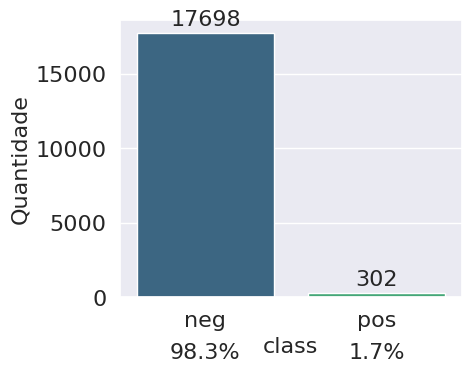

Classe Desbalanceada


In [19]:
plot_feature_freq(previous_years_data, 'class')
print('Classe Desbalanceada')

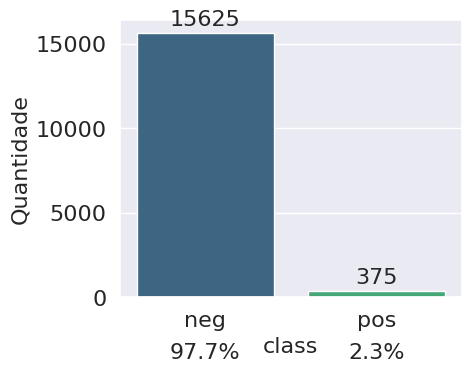

Classe Desbalanceada


In [20]:
plot_feature_freq(present_year_data, 'class')
print('Classe Desbalanceada')

## 2.2) Verificar correlações

### 2.1.1) One hot encoding manual do target

In [21]:
previous_years_data['class'] = previous_years_data['class'].map({'pos': 1, 'neg': 0})

In [22]:
present_year_data['class'] = present_year_data['class'].map({'pos': 1, 'neg': 0})

<Axes: >

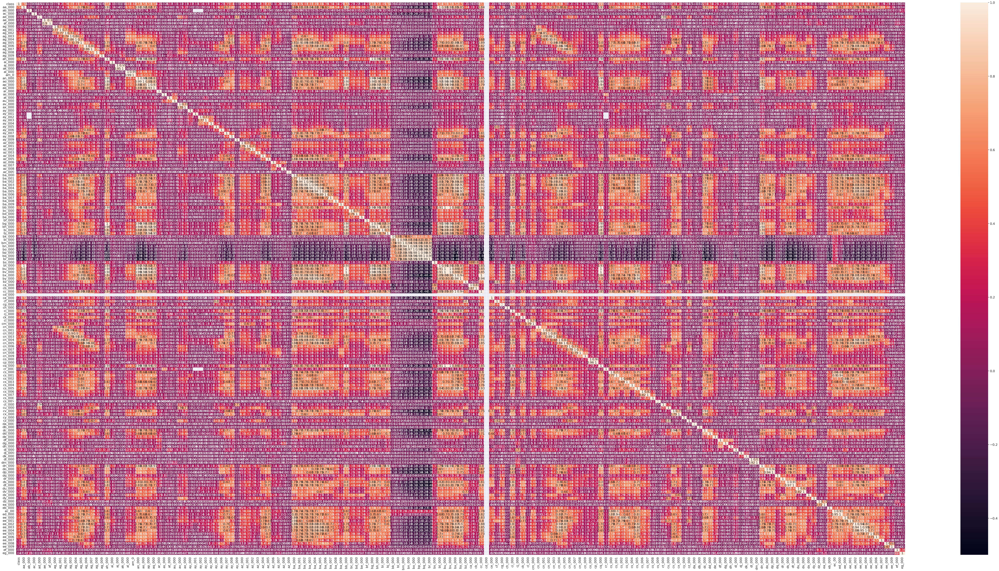

In [23]:
corr = previous_years_data.corr()

fig, ax = plt.subplots(figsize=(100,50))
sns.heatmap(corr, xticklabels = corr.columns, yticklabels = corr.columns, annot = True)

### 2.1.2) Respondendo as perguntas do InHire

In [79]:
previous_years_data['ee_003'].describe()

count      17799.00
mean      210540.13
std       499223.29
min            0.00
25%         1204.00
50%       110832.00
75%       219344.00
max     10024622.00
Name: ee_003, dtype: Float64

In [80]:
previous_years_data['ag_002'].describe()

count     17800.00
mean       9546.95
std      161043.87
min           0.00
25%           0.00
50%           0.00
75%           0.00
max     9042380.00
Name: ag_002, dtype: Float64

In [106]:
from scipy.stats import spearmanr

# Remover as linhas com valores nulos nas colunas de interesse
df_clean = previous_years_data[['ag_002', 'ee_007']].dropna()

# Calcular o coeficiente de correlação de Spearman
correlation, p_value = spearmanr(df_clean['ag_002'], df_clean['ee_007'])

print(f'Coeficiente de correlação de Spearman: {correlation}')
print(f'P-valor: {p_value}')

Coeficiente de correlação de Spearman: 0.19962903599062795
P-valor: 2.0571131562712174e-159


In [108]:
# Remover as linhas com valores nulos nas colunas de interesse
df_clean = previous_years_data[['ac_000', 'ee_005']].dropna()

# Calcular o coeficiente de correlação de Spearman
correlation, p_value = spearmanr(df_clean['ee_005'], df_clean['ac_000'])

print(f'Coeficiente de correlação de Spearman: {correlation}')
print(f'P-valor: {p_value}')

Coeficiente de correlação de Spearman: 0.3184911059643918
P-valor: 0.0


In [111]:
# Remover valores nulos da coluna 'ad_000'
df_clean = previous_years_data_teste.dropna(subset=['ad_000'])

# Agrupar pela coluna 'class' e calcular a mediana da coluna 'ad_000'
median_values = df_clean.groupby('class')['ad_000'].median()

print(median_values)

class
neg   124.00
pos   648.00
Name: ad_000, dtype: Float64


In [112]:
# Remover valores nulos da coluna 'ad_000'
df_clean = previous_years_data_teste.dropna(subset=['ee_001'])

# Agrupar pela coluna 'class' e calcular a mediana da coluna 'ad_000'
median_values = df_clean.groupby('class')['ee_001'].median()

print(median_values)

class
neg    336728.00
pos   5033236.00
Name: ee_001, dtype: Float64


In [114]:
# Contar o total de valores nulos no DataFrame
total_null_values = previous_years_data_teste.isnull().sum().sum()
total_null_values

850015

In [116]:
# Contar o número de valores nulos em cada coluna
null_counts = previous_years_data_teste.isnull().sum()

# Classificar as colunas pelo número de valores nulos em ordem decrescente
null_counts_sorted = null_counts.sort_values(ascending=False)

# Identificar a coluna na 4ª posição
column_in_4th_place = null_counts_sorted.index[3]
column_in_4th_place

'bo_000'

In [117]:
# Remover valores nulos da coluna 'ci_000'
ci_000_clean = previous_years_data_teste['ci_000'].dropna()

# Calcular o quantil 0.32 da coluna 'ci_000'
quantile_32 = ci_000_clean.quantile(0.32)

print(f'Valor do quantil 0.32 da variável ci_000: {quantile_32}')

Valor do quantil 0.32 da variável ci_000: 96517.12


***
# 3) Preparação dos dados

## 3.1) Features


In [24]:
X_train = previous_years_data.drop(['class'], axis=1)

X_train

,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,ag_003,ag_004,ag_005,ag_006,ag_007,ag_008,ag_009,ah_000,ai_000,aj_000,ak_000,al_000,am_0,an_000,ao_000,ap_000,aq_000,ar_000,as_000,at_000,au_000,av_000,ax_000,ay_000,ay_001,ay_002,ay_003,ay_004,ay_005,ay_006,ay_007,ay_008,ay_009,az_000,az_001,az_002,az_003,az_004,az_005,az_006,az_007,az_008,az_009,ba_000,ba_001,ba_002,ba_003,ba_004,ba_005,ba_006,ba_007,ba_008,ba_009,bb_000,bc_000,bd_000,be_000,bf_000,bg_000,bh_000,bi_000,bj_000,bk_000,bl_000,bm_000,bn_000,bo_000,bp_000,bq_000,br_000,bs_000,bt_000,bu_000,bv_000,bx_000,by_000,bz_000,ca_000,cb_000,cc_000,cd_000,ce_000,cf_000,cg_000,ch_000,ci_000,cj_000,ck_000,cl_000,cm_000,cn_000,cn_001,cn_002,cn_003,cn_004,cn_005,cn_006,cn_007,cn_008,cn_009,co_000,cp_000,cq_000,cr_000,cs_000,cs_001,cs_002,cs_003,cs_004,cs_005,cs_006,cs_007,cs_008,cs_009,ct_000,cu_000,cv_000,cx_000,cy_000,cz_000,da_000,db_000,dc_000,dd_000,de_000,df_000,dg_000,dh_000,di_000,dj_000,dk_000,dl_000,dm_000,dn_000,do_000,dp_000,dq_000,dr_000,ds_000,dt_000,du_000,dv_000,dx_000,dy_000,dz_000,ea_000,eb_000,ec_00,ed_000,ee_000,ee_001,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,38360,<NA>,0,<NA>,0,0,0,0,0,0,262,406596,2321672,709276,20588,0,1617448,0,0,0,0,0,2721998,2142968,828372,535020,0,0,0,0,0,0,0,0,0,0,0,573258,2883806,0,1330,0,2866,516,712,1804,2159964,1281122,11408,2,0,0,1849278,456940,203452,157682,197556,577010,16476,0,0,0,3550722,0,48,228,0,1617448,73016,353454,473930,278960,275680,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,269400,38360,3550722,3550722,3564370,18827,81872,109986,1127220,3458394,1209600,0,<NA>,<NA>,<NA>,2810733,0,643926,0,0,0,0,0,2074,689854,1816762,899086,41774,7458,1386,<NA>,0,3550722,<NA>,4792,508,47090,662168,135270,1164408,1420268,23666,224,0,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,4236,780,0,0,0,0,0,0,0,0,40138,56730,9116,0,0,177340,26996,5190340,736258,0,0,0,0,299280,1007,1050,680894,1294122,413614,128948,232640,182112,124972,104546,286396,10150,0,0
1,8,<NA>,6,6,0,0,0,0,0,0,160,2866,6150,0,0,0,1924,0,0,0,0,0,24210,22182,7194,112,0,0,0,0,6,14,0,0,0,0,0,0,0,0,9176,0,2952,26,20,42,2100,4036,0,0,0,0,4950,514,70,84,64,178,2058,1258,0,0,31432,0,2,0,0,1924,154,6112,1062,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,7040,8,31432,31432,37258,84,0,3038,31260,9176,1209600,278,2,6,0,1795,0,2369,0,22,0,0,18,2690,2172,3472,824,0,0,0,0,4,31432,<NA>,5046,26,16,18,10,868,2840,348,4,0,2,12,1870,34,0,0,0,0,2002,46,60,0,0,0,0,0,0,0,0,156,0,0,0,0,10,2,5040,510,0,0,0,0,0,93,56,4682,1436,26,8,2892,18,94,20,0,0,0,0
2,43980,<NA>,212,176,0,0,0,0,0,0,502,11228,1779768,1398660,63606,1800,1562598,0,538,0,0,0,2815070,2435856,576446,302232,0,0,0,0,560,188,0,0,0,0,0,0,86800,912844,2255920,0,4584,3022,2794,289770,2488176,467196,22,0,0,0,1412050,581336,287832,242858,244032,480572,6884,0,0,0,3392380,0,26,78,24,1562598,48050,225064,347818,220160,194520,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,153860,43979,3392380,3392380,3388002,19178,924,91230,964780,3255564,1209600,112410,0,216,0,2597114,0,654748,0,0,0,0,0,440,195016,1606770,1341874,99748,10440,1276,52,72,3392380,<NA>,6908,778,115254,451994,188562,1639048,839076,13840,104,0,342,374,2592342,2854,0,786,0,0,2671284,3126,1208,0,0,0,0,0,0,0,0,25546,53270,8632,0,0,111912,20578,139240,16534,0,0,0,0,3979280,1639,1662,684446,647080,409274,193536,374626,270080,234822,163272,249406,29022,0,0
3,47196,<NA>,344,310,0,0,0,0,0,0,2166,115448,2222024,822046,22630,402,1240042,0,0,0,0,0,2820556,2360462,693424,366404,0,0,0,0,914,490,0,0,0,0,0,59322,1481660,1421142,222592,0,4304,2768,3420,17876,2130582,1025730,36,0,0,0,1257132,748210,296994,197982,142730,111232,162078,268198,160,0,3514778,196,100,244,10,1240042,33214,364946,324754,233620,232620,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,218240,47196,3514778,3514778,3493844,18980,3588,102598,1086140,3184716,1209600,91052,2,62,0,2781545,36,400001,0,0,0,0,0,5604,792166,1861046,480704,36718,7884,594,0,6,3514778,<NA>,6816,906,109872,196804,187622,2335434,338336,8824,102,0,498,1450,2603318,15280,0,9

In [25]:
X_test = present_year_data.drop(['class'], axis=1)

X_test

,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,ag_003,ag_004,ag_005,ag_006,ag_007,ag_008,ag_009,ah_000,ai_000,aj_000,ak_000,al_000,am_0,an_000,ao_000,ap_000,aq_000,ar_000,as_000,at_000,au_000,av_000,ax_000,ay_000,ay_001,ay_002,ay_003,ay_004,ay_005,ay_006,ay_007,ay_008,ay_009,az_000,az_001,az_002,az_003,az_004,az_005,az_006,az_007,az_008,az_009,ba_000,ba_001,ba_002,ba_003,ba_004,ba_005,ba_006,ba_007,ba_008,ba_009,bb_000,bc_000,bd_000,be_000,bf_000,bg_000,bh_000,bi_000,bj_000,bk_000,bl_000,bm_000,bn_000,bo_000,bp_000,bq_000,br_000,bs_000,bt_000,bu_000,bv_000,bx_000,by_000,bz_000,ca_000,cb_000,cc_000,cd_000,ce_000,cf_000,cg_000,ch_000,ci_000,cj_000,ck_000,cl_000,cm_000,cn_000,cn_001,cn_002,cn_003,cn_004,cn_005,cn_006,cn_007,cn_008,cn_009,co_000,cp_000,cq_000,cr_000,cs_000,cs_001,cs_002,cs_003,cs_004,cs_005,cs_006,cs_007,cs_008,cs_009,ct_000,cu_000,cv_000,cx_000,cy_000,cz_000,da_000,db_000,dc_000,dd_000,de_000,df_000,dg_000,dh_000,di_000,dj_000,dk_000,dl_000,dm_000,dn_000,do_000,dp_000,dq_000,dr_000,ds_000,dt_000,du_000,dv_000,dx_000,dy_000,dz_000,ea_000,eb_000,ec_00,ed_000,ee_000,ee_001,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,60,0,20,12,0,0,0,0,0,2682,4736,3862,1846,0,0,0,3976,0,0,0,1520,2374,11516,9480,111258,470,0,0,0,0,58,26,0,0,0,0,0,0,0,0,13124,2,1956,434,76,174,190,6198,1148,2948,2,0,8762,2566,480,380,196,516,86,66,74,0,124340,4,6,4,0,3976,318,107662,3458,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,110980,59,124340,124340,184970,54,686,12246,123880,13196,1209600,598,0,6,0,5913,0,5851,6,30,0,2,5512,4674,1388,1508,38,4,0,0,8,12,124340,0,1550,14,36,26,920,430,7650,2294,206,0,22,42,5336,1276,0,0,0,0,6598,70,112,0,0,0,0,0,0,0,0,340,0,0,1100,574,232,66,780,882,0,4,0,0,0,465,90,7502,3156,1098,138,412,654,78,88,0,0,0,0
1,82,0,68,40,0,0,0,0,0,0,748,12594,3636,0,0,0,5244,0,60,0,0,0,23174,18166,23686,1270,0,0,0,0,12,82,0,0,0,0,0,0,0,692,16286,0,280,44,50,1274,866,3362,11102,0,0,0,12564,1756,638,276,172,132,812,308,192,128,46894,4,2,38,0,5244,360,20520,3134,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,23320,81,46894,46894,48324,68,0,4486,46480,17050,1209600,726,2,4,0,7224,0,7768,0,42,0,0,4,7064,6200,2452,1246,12,0,0,14,54,46894,0,2202,28,114,350,700,1708,9622,2174,80,0,80,206,7802,1466,0,0,0,0,7918,78,40,0,0,0,0,0,0,0,0,352,0,0,3996,584,200,62,37580,3756,6368,36,0,0,0,2,102,10040,3310,1068,276,1620,116,86,462,0,0,0,0
2,66002,2,212,112,0,0,0,0,0,199486,1358536,1952422,452706,25130,520,0,1891670,0,0,0,77898,110548,3605894,3291610,959756,286536,0,0,0,0,106,340,0,0,0,0,0,24286,681260,2808472,474782,0,22984,894,1162,1304,1856,388700,3424812,123828,23260,0,1662580,667960,387998,226078,161558,148288,154908,220820,147744,210866,4644422,958,7848,3624,0,1891670,47066,692800,265492,336240,194360,245240,<NA>,<NA>,<NA>,<NA>,<NA>,175480,66002,4644422,4644422,4608738,22706,2272,95510,1006260,3991552,1209600,126310,0,104,0,3594885,0,374649,148,720,0,5154,174956,622312,1002504,793938,541734,345896,300806,201500,52,92,4644422,0,24818,964,162660,215004,217930,3038612,322718,6080,14,0,226,572,3593728,1911060,0,284,0,0,3613906,4218,692,0,0,0,0,0,0,0,0,25278,9438,2504,10262714,1278664,109700,19072,9520,4902,4434614,70900,0,0,26002880,2057,2158,396312,538136,495076,380368,440134,269556,1315022,153680,516,0,0,0
3,59816,<NA>,1010,936,0,0,0,0,0,0,123922,984314,1680050,1135268,92606,14038,1772828,0,0,0,1116,2372,3546760,3053176,652616,423374,0,0,7274,0,1622,432,0,0,0,0,0,6388,1091104,2930694,2012,0,3526,904,1426,223226,2663348,1137664,104,0,0,0,1283806,928212,345132,265930,194770,158262,219942,620264,13880,0,4201350,98,238,880,16,1772828,51468,331744,316130,176000,208420,159380,<NA>,<NA>,<NA>,<NA>,<NA>,100120,59816,4201350,4201350,4203050,29967,26214,51894,562680,4030198,1209600,114684,0,144,0,3387773,38633,599624,0,0,0,0,14308,475410,1109740,1528024,837114,58942,6220,440,1278,1292,4201350,<NA>,6846,810,70090,345884,191284,2454600,926846,33558,280,0,1516,1398,2050280,64066,0,674,0,46,3413978,2924,414,0,0,60,38710,0,0,0,0,2

## 3.2) Target

In [26]:
label_y_train = previous_years_data['class']

label_y_train

0        0
1        0
2        0
3        0
4        0
        ..
17995    0
17996    0
17997    0
17998    0
17999    0
Name: class, Length: 18000, dtype: int64

In [27]:
label_y_test = present_year_data['class']

label_y_test

0        0
1        0
2        0
3        0
4        0
        ..
15995    0
15996    0
15997    0
15998    0
15999    0
Name: class, Length: 16000, dtype: int64

### 3.2.1) Contagem dados de Target de categorico para numérico

In [29]:
 np.unique(label_y_train, return_counts=True)

(array([0, 1]), array([17698,   302]))

In [30]:
 np.unique(label_y_test, return_counts=True)

(array([0, 1]), array([15625,   375]))

## - Dados 'neg' são representados por 0

## - Dados 'pos' são representados por 1

## 2.3) Variaveis Categoricas

In [31]:
# Criando uma lista de variaveis categoricas
s = (X_train.dtypes == 'object')
object_cols = list(s[s].index)
print("Categorical variables: ", len(object_cols))
print(object_cols)

Categorical variables:  0
[]


## 2.4) Variaveis Numéricas

In [32]:
# Criando uma lista de variáveis numéricas
numerical_cols = [cname for cname in X_train.columns if pd.api.types.is_numeric_dtype(X_train[cname])]
print("Numerical variables: ", len(numerical_cols))
print(numerical_cols)

Numerical variables:  170
['aa_000', 'ab_000', 'ac_000', 'ad_000', 'ae_000', 'af_000', 'ag_000', 'ag_001', 'ag_002', 'ag_003', 'ag_004', 'ag_005', 'ag_006', 'ag_007', 'ag_008', 'ag_009', 'ah_000', 'ai_000', 'aj_000', 'ak_000', 'al_000', 'am_0', 'an_000', 'ao_000', 'ap_000', 'aq_000', 'ar_000', 'as_000', 'at_000', 'au_000', 'av_000', 'ax_000', 'ay_000', 'ay_001', 'ay_002', 'ay_003', 'ay_004', 'ay_005', 'ay_006', 'ay_007', 'ay_008', 'ay_009', 'az_000', 'az_001', 'az_002', 'az_003', 'az_004', 'az_005', 'az_006', 'az_007', 'az_008', 'az_009', 'ba_000', 'ba_001', 'ba_002', 'ba_003', 'ba_004', 'ba_005', 'ba_006', 'ba_007', 'ba_008', 'ba_009', 'bb_000', 'bc_000', 'bd_000', 'be_000', 'bf_000', 'bg_000', 'bh_000', 'bi_000', 'bj_000', 'bk_000', 'bl_000', 'bm_000', 'bn_000', 'bo_000', 'bp_000', 'bq_000', 'br_000', 'bs_000', 'bt_000', 'bu_000', 'bv_000', 'bx_000', 'by_000', 'bz_000', 'ca_000', 'cb_000', 'cc_000', 'cd_000', 'ce_000', 'cf_000', 'cg_000', 'ch_000', 'ci_000', 'cj_000', 'ck_000', 'cl_0

***
# 4) Modelagem dos dados


## 4.1) Dividindo as features em dados de treino e validação

Já foi feita a divisão, onde:

- os dados de treinamento ficaram a cargo do dataset previous_years_data (X_train e y_train)
- os dados de teste ficaram a cargo do dataset present_year_data (X_test e y_test)

## 4.2) Pipeline 

StandardScaler resulta em uma distribuição com desvio padrão igual a 1. A variância também é igual a 1, porque variância = desvio padrão ao quadrado. E 1 ao quadrado = 1.

StandardScaler torna a média da distribuição 0. Cerca de 68% dos valores estarão entre -1 e 1.

Os algoritmos de aprendizado profundo geralmente exigem média zero e variação de unidade. Algoritmos do tipo regressão também se beneficiam de dados normalmente distribuídos com tamanhos de amostra pequenos.


### 4.2.1) Pré-processamento para Dados Numéricos

In [33]:
# StandardScaler resulta em uma distribuição com desvio padrão igual a 1. A variância também é igual a 1, porque variância = desvio padrão ao quadrado. E 1 ao quadrado = 1.

# StandardScaler torna a média da distribuição 0. Cerca de 68% dos valores estarão entre -1 e 1.

# Os algoritmos de aprendizado profundo geralmente exigem média zero e variação de unidade. Algoritmos do tipo regressão também se beneficiam de dados normalmente distribuídos com tamanhos de amostra pequenos.


numerical_transformer = Pipeline([
                                  ('scaler', StandardScaler())
                                 ])

### 4.2.2) Pré-processamento para Dados Categóricos - não há dados categoricos, pois já foi feita a conversão manualmente da coluna (target) em dados numéricos



- Dados 'neg' são representados por 0
- Dados 'pos' são representados por 1

In [34]:
# # Pré-processamento para Dados Categóricos
# categorical_transformer = Pipeline([
#                                     ('onehot', OneHotEncoder(handle_unknown='ignore')) # transforma dados categoricos em numéricos
#                                    ])

#### 4.2.3) Pré-processamento de pacote de dados numéricos e categóricos

In [35]:
# Pré-processamento de pacote de dados numéricos e categóricos
preprocessor = ColumnTransformer(transformers=[
                                                ('num', numerical_transformer, numerical_cols),
#                                                 ('cat', categorical_transformer, object_cols)
                                              ], n_jobs=-1)

### 4.2.4) Pipeline

In [36]:
pipeline = Pipeline(steps=[
                            ('preprocessor', preprocessor),
                            ('imputation', KNNImputer()), # preencher os dados vazios com knn
                            ('smote', SMOTE(random_state=42, n_jobs=-1)), # função para balancear a classe 'class'
                            ('PCA', PCA(n_components=30)), # Seleção de Variáveis e Redução de Dimensionalidade
#                             ('svd', TruncatedSVD(n_components=30)), # Seleção de Variáveis e Redução de Dimensionalidade com TruncatedSVD
                            ('model', RandomForestClassifier(random_state=2048, n_jobs=-1))
                          ])

### 4.2.5) Fit

In [37]:
# Preprocessing of training data, fit model 
pipeline.fit(X_train, label_y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(n_jobs=-1,
                                   transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   StandardScaler())]),
                                                  ['aa_000', 'ab_000', 'ac_000',
                                                   'ad_000', 'ae_000', 'af_000',
                                                   'ag_000', 'ag_001', 'ag_002',
                                                   'ag_003', 'ag_004', 'ag_005',
                                                   'ag_006', 'ag_007', 'ag_008',
                                                   'ag_009', 'ah_000', 'ai_000',
                                                   'aj_000', 'ak_000', 'al_000',
                                                   'am_0', 'an_000', 'ao_000',
                                                   'ap_000', 'aq_000', 'ar_000',
                                                   'as_000', 'at_000', 'au_000', ...])])),
                ('imputation', KNNImputer()),
                ('smote', SMOTE(n_jobs=-1, random_state=42)),
                ('PCA', PCA(n_components=30)),
                ('model',
                 RandomForestClassifier(n_jobs=-1, random_state=2048))])

### 4.2.6) Previsão

In [38]:
preds = pipeline.predict(X_test)

In [39]:
# contagem de classes
c_preds = Counter(preds)
c_preds

Counter({0: 15454, 1: 546})

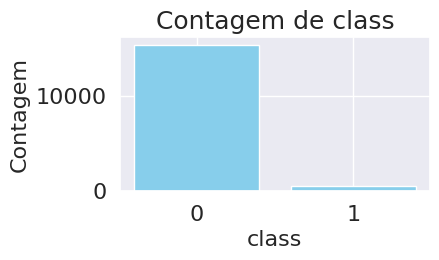

In [40]:
# Contar as classes
unique_classes, counts = np.unique(preds, return_counts=True)

# Plotar gráfico de barras
plt.figure(figsize=(4, 2))
plt.bar(unique_classes, counts, color='skyblue')
plt.xlabel('class')
plt.ylabel('Contagem')
plt.title('Contagem de class')
plt.xticks(unique_classes)
plt.show()

## 4.3) Cross Validation

In [55]:
scores = cross_validate(pipeline, 
                        X_train, 
                        label_y_train, 
                        cv=5, 
                        scoring=('accuracy', 'precision', 'recall', 'f1', 'roc_auc'))
# scores

In [56]:
print(scores['test_accuracy'])

[0.98055556 0.98138889 0.97722222 0.98277778 0.98611111]


In [57]:
print(scores['test_precision'])

[0.44791667 0.46534653 0.4140625  0.4953271  0.55670103]


In [58]:
print(scores['test_recall'])

[0.71666667 0.78333333 0.88333333 0.86885246 0.8852459 ]


In [59]:
print(scores['test_f1'])

[0.55128205 0.58385093 0.56382979 0.63095238 0.6835443 ]


In [60]:
print(scores['test_roc_auc'])

[0.97082392 0.97937147 0.97682439 0.99039508 0.97795061]


***
# 5) Avaliação do modelo

## 5.1) Métricas

### 5.1.1) 'Acurácia' é a quantidade de acertos do nosso modelo dividido pelo total da amostra

A 'acurácia' não é uma medida muito boa para trabalhar com modelos de classificação pois ela pode nos induzir a achar que um modelo
que prediz corretamente todos os zeros mas nenhum um é um modelo muito bom indica uma performance geral do modelo

[VN + VP]/[VN + VP + FN + FP])

In [61]:
def aucur(y_test, preds):
    # calculate AUC
    aucur = roc_auc_score(y_test, preds)
    print('AUC: %.3f' % aucur)

    # calculate roc curve
    fpr, tpr, thresholds = roc_curve(y_test, preds)

    # plot no skill
    plt.figure(figsize=(4, 3))
    plt.plot([0, 1], [0, 1], linestyle='--')
    # plot the roc curve for the model
    plt.plot(fpr, tpr, marker='.')
    # show the plot
    plt.show()

AUC: 0.925


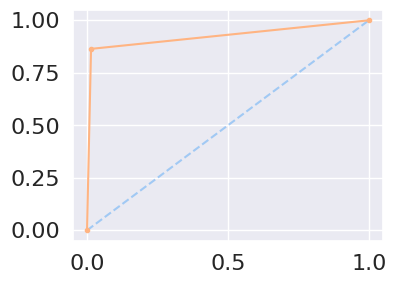

In [62]:
aucur(label_y_test, preds)

### 5.1.2) Classification Report

In [63]:
print(classification_report(label_y_test, preds))

              precision    recall  f1-score   support

           0       1.00      0.99      0.99     15625
           1       0.59      0.86      0.70       375

    accuracy                           0.98     16000
   macro avg       0.80      0.92      0.85     16000
weighted avg       0.99      0.98      0.98     16000



### Considerando que o custo de manutenção do sistema de ar é de 'R 25,00' e para os demais é de R 10,00, é importante que o modelo seja preciso ao apontar quando o erro é nos sistemas de ar, para que não haja custos desnecessários. Portanto, é importante que haja menos falsos positivos possíveis (alta precisão)

No caso, precisão de 0,59 é relativamente baixo para a questão, então seria importante ir além do base line e trabalhar com a tunagem de hiperparametros para tentar melhorar o resultado

ou então

Adicionar mais dados ao treinamento para aumentar a variabilidade dos dados no treinamento

### 5.1.3) Matriz de Confusão

In [64]:
cm_df = pd.DataFrame(confusion_matrix(label_y_test, preds),
                     index = sorted(Counter(label_y_test)),
                     columns = sorted(Counter(preds)))
cm_df

,0,1
0,15403,222
1,51,324


Confusion matrix, without normalization
[[15403   222]
 [   51   324]]
Normalized confusion matrix
[[0.985792 0.014208]
 [0.136    0.864   ]]


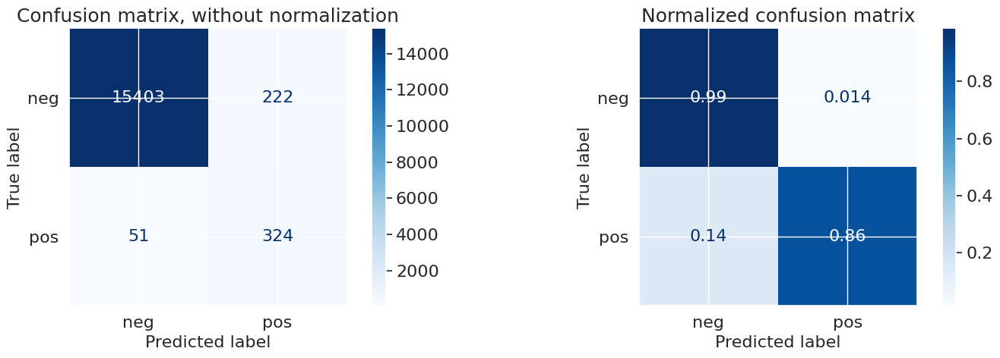

In [65]:
titles_options = [
    ("Confusion matrix, without normalization", None),
    ("Normalized confusion matrix", "true"),
]

# Criando uma figura geral para as matrizes de confusão
fig, axes = plt.subplots(1, len(titles_options), figsize=(15, 5))

for ax, (title, normalize) in zip(axes, titles_options):
    disp = ConfusionMatrixDisplay.from_estimator(
        pipeline,
        X_test,
        label_y_test,
        display_labels=['neg', 'pos'],
        cmap=plt.cm.Blues,
        normalize=normalize,
        ax=ax  # Utilizando o eixo específico para cada matriz de confusão
    )
    disp.ax_.set_title(title)
    print(title)
    print(disp.confusion_matrix)

plt.tight_layout()  # Ajuste de layout para melhor organização
plt.show()

## Novamente, considerando que o custo de manutenção do sistema de ar é de 'R 25,00' e para os demais é de R 10,00, é importante que o modelo seja preciso ao apontar quando o erro é nos sistemas de ar, para que não haja custos desnecessários. Portanto, é importante que haja menos falsos positivos possíveis (alta precisão)

### O modelo previu 222 Falsos Positivos e 324 Verdadeiros Positivos, sendo assim o Precision é  (324 / (324 +  222)) = 0,59

No caso, precisão de 0,59 é relativamente baixo para a questão, então vale a pena ir além do base line e trabalhar com a tunagem de hiperparametros para tentar melhorar o resultado

ou então

Adicionar mais dados ao treinamento para aumentar a variabilidade dos dados no treinamento


### O modelo previu 51 Falsos Negativos e 324 Verdadeiros Positivos, sendo assim o Precision é  (324 / (324  + 51)) = 0,86

### 5.4) Tunagem de hiperparametros

In [66]:
# from sklearn.model_selection import GridSearchCV

# # Definir a grade de parâmetros para o GridSearchCV
# param_grid = {
#     'model__n_estimators': [50, 100, 200],
#     'model__max_features': ['auto', 'sqrt', 'log2'],
#     'model__max_depth': [10, 20, 30, None],
#     'model__criterion': ['gini', 'entropy']
# }

# # Criar o objeto GridSearchCV
# grid_search = GridSearchCV(estimator=pipeline, param_grid=param_grid, cv=5, scoring='roc_auc', n_jobs=-1, verbose=2)

# # Treinar o GridSearchCV
# grid_search.fit(X_train, label_y_train)

# # Melhor modelo após a otimização
# best_rf_model = grid_search.best_estimator_

# # Resultados da melhor busca
# print("Melhores parâmetros encontrados:", grid_search.best_params_)
# print("Melhor pontuação de validação cruzada (roc_auc):", grid_search.best_score_)

# # Avaliar o modelo no conjunto de teste
# test_score = best_rf_model.score(X_test, y_test)
# print("Pontuação no conjunto de teste:", test_score)


***
# 6) Preparação para salvar os dados com a previsão num arquivo CSV

In [72]:
X_test_file = X_test.reset_index(drop=True)
X_test_file

,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,ag_003,ag_004,ag_005,ag_006,ag_007,ag_008,ag_009,ah_000,ai_000,aj_000,ak_000,al_000,am_0,an_000,ao_000,ap_000,aq_000,ar_000,as_000,at_000,au_000,av_000,ax_000,ay_000,ay_001,ay_002,ay_003,ay_004,ay_005,ay_006,ay_007,ay_008,ay_009,az_000,az_001,az_002,az_003,az_004,az_005,az_006,az_007,az_008,az_009,ba_000,ba_001,ba_002,ba_003,ba_004,ba_005,ba_006,ba_007,ba_008,ba_009,bb_000,bc_000,bd_000,be_000,bf_000,bg_000,bh_000,bi_000,bj_000,bk_000,bl_000,bm_000,bn_000,bo_000,bp_000,bq_000,br_000,bs_000,bt_000,bu_000,bv_000,bx_000,by_000,bz_000,ca_000,cb_000,cc_000,cd_000,ce_000,cf_000,cg_000,ch_000,ci_000,cj_000,ck_000,cl_000,cm_000,cn_000,cn_001,cn_002,cn_003,cn_004,cn_005,cn_006,cn_007,cn_008,cn_009,co_000,cp_000,cq_000,cr_000,cs_000,cs_001,cs_002,cs_003,cs_004,cs_005,cs_006,cs_007,cs_008,cs_009,ct_000,cu_000,cv_000,cx_000,cy_000,cz_000,da_000,db_000,dc_000,dd_000,de_000,df_000,dg_000,dh_000,di_000,dj_000,dk_000,dl_000,dm_000,dn_000,do_000,dp_000,dq_000,dr_000,ds_000,dt_000,du_000,dv_000,dx_000,dy_000,dz_000,ea_000,eb_000,ec_00,ed_000,ee_000,ee_001,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,60,0,20,12,0,0,0,0,0,2682,4736,3862,1846,0,0,0,3976,0,0,0,1520,2374,11516,9480,111258,470,0,0,0,0,58,26,0,0,0,0,0,0,0,0,13124,2,1956,434,76,174,190,6198,1148,2948,2,0,8762,2566,480,380,196,516,86,66,74,0,124340,4,6,4,0,3976,318,107662,3458,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,110980,59,124340,124340,184970,54,686,12246,123880,13196,1209600,598,0,6,0,5913,0,5851,6,30,0,2,5512,4674,1388,1508,38,4,0,0,8,12,124340,0,1550,14,36,26,920,430,7650,2294,206,0,22,42,5336,1276,0,0,0,0,6598,70,112,0,0,0,0,0,0,0,0,340,0,0,1100,574,232,66,780,882,0,4,0,0,0,465,90,7502,3156,1098,138,412,654,78,88,0,0,0,0
1,82,0,68,40,0,0,0,0,0,0,748,12594,3636,0,0,0,5244,0,60,0,0,0,23174,18166,23686,1270,0,0,0,0,12,82,0,0,0,0,0,0,0,692,16286,0,280,44,50,1274,866,3362,11102,0,0,0,12564,1756,638,276,172,132,812,308,192,128,46894,4,2,38,0,5244,360,20520,3134,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,23320,81,46894,46894,48324,68,0,4486,46480,17050,1209600,726,2,4,0,7224,0,7768,0,42,0,0,4,7064,6200,2452,1246,12,0,0,14,54,46894,0,2202,28,114,350,700,1708,9622,2174,80,0,80,206,7802,1466,0,0,0,0,7918,78,40,0,0,0,0,0,0,0,0,352,0,0,3996,584,200,62,37580,3756,6368,36,0,0,0,2,102,10040,3310,1068,276,1620,116,86,462,0,0,0,0
2,66002,2,212,112,0,0,0,0,0,199486,1358536,1952422,452706,25130,520,0,1891670,0,0,0,77898,110548,3605894,3291610,959756,286536,0,0,0,0,106,340,0,0,0,0,0,24286,681260,2808472,474782,0,22984,894,1162,1304,1856,388700,3424812,123828,23260,0,1662580,667960,387998,226078,161558,148288,154908,220820,147744,210866,4644422,958,7848,3624,0,1891670,47066,692800,265492,336240,194360,245240,<NA>,<NA>,<NA>,<NA>,<NA>,175480,66002,4644422,4644422,4608738,22706,2272,95510,1006260,3991552,1209600,126310,0,104,0,3594885,0,374649,148,720,0,5154,174956,622312,1002504,793938,541734,345896,300806,201500,52,92,4644422,0,24818,964,162660,215004,217930,3038612,322718,6080,14,0,226,572,3593728,1911060,0,284,0,0,3613906,4218,692,0,0,0,0,0,0,0,0,25278,9438,2504,10262714,1278664,109700,19072,9520,4902,4434614,70900,0,0,26002880,2057,2158,396312,538136,495076,380368,440134,269556,1315022,153680,516,0,0,0
3,59816,<NA>,1010,936,0,0,0,0,0,0,123922,984314,1680050,1135268,92606,14038,1772828,0,0,0,1116,2372,3546760,3053176,652616,423374,0,0,7274,0,1622,432,0,0,0,0,0,6388,1091104,2930694,2012,0,3526,904,1426,223226,2663348,1137664,104,0,0,0,1283806,928212,345132,265930,194770,158262,219942,620264,13880,0,4201350,98,238,880,16,1772828,51468,331744,316130,176000,208420,159380,<NA>,<NA>,<NA>,<NA>,<NA>,100120,59816,4201350,4201350,4203050,29967,26214,51894,562680,4030198,1209600,114684,0,144,0,3387773,38633,599624,0,0,0,0,14308,475410,1109740,1528024,837114,58942,6220,440,1278,1292,4201350,<NA>,6846,810,70090,345884,191284,2454600,926846,33558,280,0,1516,1398,2050280,64066,0,674,0,46,3413978,2924,414,0,0,60,38710,0,0,0,0,2

In [73]:
y_test_file = label_y_test.reset_index(drop=True)
y_test_file

0        0
1        0
2        0
3        0
4        0
        ..
15995    0
15996    0
15997    0
15998    0
15999    0
Name: class, Length: 16000, dtype: int64

In [77]:
 np.unique(y_test_file, return_counts=True)

(array([0, 1]), array([15625,   375]))

In [74]:
df_preds = pd.DataFrame(preds, columns=['preds'])
df_preds

,preds
0,0
1,0
2,0
3,0
4,0
...,...
15995,0
15996,0
15997,0
15998,0


In [75]:
df_output = X_test_file.join([y_test_file, df_preds]).reset_index(drop=True)
df_output

,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,ag_003,ag_004,ag_005,ag_006,ag_007,ag_008,ag_009,ah_000,ai_000,aj_000,ak_000,al_000,am_0,an_000,ao_000,ap_000,aq_000,ar_000,as_000,at_000,au_000,av_000,ax_000,ay_000,ay_001,ay_002,ay_003,ay_004,ay_005,ay_006,ay_007,ay_008,ay_009,az_000,az_001,az_002,az_003,az_004,az_005,az_006,az_007,az_008,az_009,ba_000,ba_001,ba_002,ba_003,ba_004,ba_005,ba_006,ba_007,ba_008,ba_009,bb_000,bc_000,bd_000,be_000,bf_000,bg_000,bh_000,bi_000,bj_000,bk_000,bl_000,bm_000,bn_000,bo_000,bp_000,bq_000,br_000,bs_000,bt_000,bu_000,bv_000,bx_000,by_000,bz_000,ca_000,cb_000,cc_000,cd_000,ce_000,cf_000,cg_000,ch_000,ci_000,cj_000,ck_000,cl_000,cm_000,cn_000,cn_001,cn_002,cn_003,cn_004,cn_005,cn_006,cn_007,cn_008,cn_009,co_000,cp_000,cq_000,cr_000,cs_000,cs_001,cs_002,cs_003,cs_004,cs_005,cs_006,cs_007,cs_008,cs_009,ct_000,cu_000,cv_000,cx_000,cy_000,cz_000,da_000,db_000,dc_000,dd_000,de_000,df_000,dg_000,dh_000,di_000,dj_000,dk_000,dl_000,dm_000,dn_000,do_000,dp_000,dq_000,dr_000,ds_000,dt_000,du_000,dv_000,dx_000,dy_000,dz_000,ea_000,eb_000,ec_00,ed_000,ee_000,ee_001,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000,class,preds
0,60,0,20,12,0,0,0,0,0,2682,4736,3862,1846,0,0,0,3976,0,0,0,1520,2374,11516,9480,111258,470,0,0,0,0,58,26,0,0,0,0,0,0,0,0,13124,2,1956,434,76,174,190,6198,1148,2948,2,0,8762,2566,480,380,196,516,86,66,74,0,124340,4,6,4,0,3976,318,107662,3458,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,110980,59,124340,124340,184970,54,686,12246,123880,13196,1209600,598,0,6,0,5913,0,5851,6,30,0,2,5512,4674,1388,1508,38,4,0,0,8,12,124340,0,1550,14,36,26,920,430,7650,2294,206,0,22,42,5336,1276,0,0,0,0,6598,70,112,0,0,0,0,0,0,0,0,340,0,0,1100,574,232,66,780,882,0,4,0,0,0,465,90,7502,3156,1098,138,412,654,78,88,0,0,0,0,0,0
1,82,0,68,40,0,0,0,0,0,0,748,12594,3636,0,0,0,5244,0,60,0,0,0,23174,18166,23686,1270,0,0,0,0,12,82,0,0,0,0,0,0,0,692,16286,0,280,44,50,1274,866,3362,11102,0,0,0,12564,1756,638,276,172,132,812,308,192,128,46894,4,2,38,0,5244,360,20520,3134,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,23320,81,46894,46894,48324,68,0,4486,46480,17050,1209600,726,2,4,0,7224,0,7768,0,42,0,0,4,7064,6200,2452,1246,12,0,0,14,54,46894,0,2202,28,114,350,700,1708,9622,2174,80,0,80,206,7802,1466,0,0,0,0,7918,78,40,0,0,0,0,0,0,0,0,352,0,0,3996,584,200,62,37580,3756,6368,36,0,0,0,2,102,10040,3310,1068,276,1620,116,86,462,0,0,0,0,0,0
2,66002,2,212,112,0,0,0,0,0,199486,1358536,1952422,452706,25130,520,0,1891670,0,0,0,77898,110548,3605894,3291610,959756,286536,0,0,0,0,106,340,0,0,0,0,0,24286,681260,2808472,474782,0,22984,894,1162,1304,1856,388700,3424812,123828,23260,0,1662580,667960,387998,226078,161558,148288,154908,220820,147744,210866,4644422,958,7848,3624,0,1891670,47066,692800,265492,336240,194360,245240,<NA>,<NA>,<NA>,<NA>,<NA>,175480,66002,4644422,4644422,4608738,22706,2272,95510,1006260,3991552,1209600,126310,0,104,0,3594885,0,374649,148,720,0,5154,174956,622312,1002504,793938,541734,345896,300806,201500,52,92,4644422,0,24818,964,162660,215004,217930,3038612,322718,6080,14,0,226,572,3593728,1911060,0,284,0,0,3613906,4218,692,0,0,0,0,0,0,0,0,25278,9438,2504,10262714,1278664,109700,19072,9520,4902,4434614,70900,0,0,26002880,2057,2158,396312,538136,495076,380368,440134,269556,1315022,153680,516,0,0,0,0,0
3,59816,<NA>,1010,936,0,0,0,0,0,0,123922,984314,1680050,1135268,92606,14038,1772828,0,0,0,1116,2372,3546760,3053176,652616,423374,0,0,7274,0,1622,432,0,0,0,0,0,6388,1091104,2930694,2012,0,3526,904,1426,223226,2663348,1137664,104,0,0,0,1283806,928212,345132,265930,194770,158262,219942,620264,13880,0,4201350,98,238,880,16,1772828,51468,331744,316130,176000,208420,159380,<NA>,<NA>,<NA>,<NA>,<NA>,100120,59816,4201350,4201350,4203050,29967,26214,51894,562680,4030198,1209600,114684,0,144,0,3387773,38633,599624,0,0,0,0,14308,475410,1109740,1528024,837114,58942,6220,440,1278,1292,4201350,<NA>,6846,810,70090,345884,191284,2454600,926846,33558,280,0,1516,1398,2050280,64066,0,674,0,46,3413978,2924,41

In [76]:
end=timeit.default_timer()

check_time(start, end)

0.0 dias 1.0 horas 52.0 minutos e 26.43 segundos
